In [55]:

# # Uncomment to widen notebook cells for PDf export
# from IPython.core.display import display, HTML
# display(HTML("<style>.container { width:100% !important; }</style>"))

# Image Processing Lab 3
## Zhanwen (Phil) Chen

1.

This problem explores the changes in color that occur when the individual bands of a true-color image are transformed independently of each other.
Find a truecolor image that contains a wide range of colors. Use the gamma correction function you wrote for Lab Assignment 2 to increase and decrease the overall brightness of each band separately. Display the original image and the 6 altered versions. Describe the differences between the images. Here, I recommend that you cut the same small region out of the original and the 6 altered images so that you can display them all on the same page together. These need not be enlarged. See Figure 1.

In [2]:
import numpy as np

def get_lut_gamma(gamma):
    adjusted = np.power(np.arange(256)/255, 1.0/gamma) * 255
    return np.rint(adjusted).clip(0, 255).astype('uint8')

def gamma_adjust(image, gamma, which_band=-1):
    lut_gamma = get_lut_gamma(gamma)
    if which_band == -1:
        return lut_gamma[image]
    
    new_channel = lut_gamma[image[:, :, which_band]]
    if which_band == 0:
        return np.dstack([new_channel, image[:, :, 1], image[:, :, 2]])
    
    if which_band == 1:
        return np.dstack([image[:, :, 0], new_channel, image[:, :, 2]])
    
    if which_band == 2:
        return np.dstack([image[:, :, 0], image[:, :, 1], new_channel])

Populating the interactive namespace from numpy and matplotlib


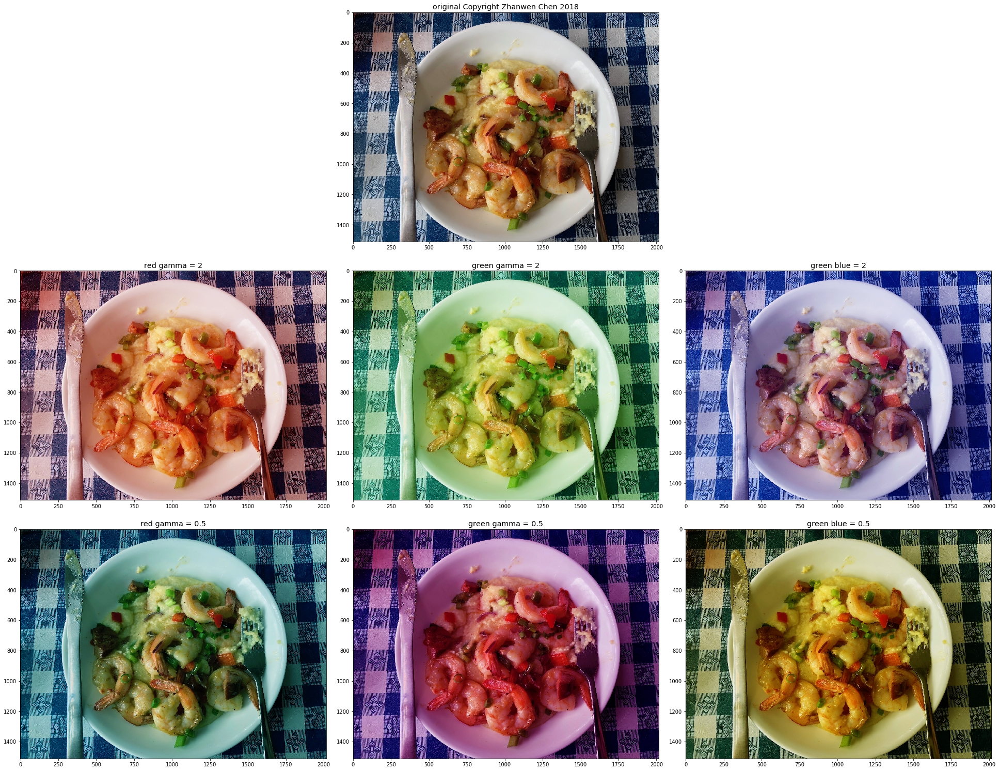

In [3]:
import matplotlib.pyplot as plt
%matplotlib inline
%pylab inline

import matplotlib as mpl
mpl.rcParams['axes.titlesize'] = 'x-large'

image_fname = 'nashville_jam_cafe.jpg'
image_original = plt.imread(image_fname)

image_gamma_red_2 = gamma_adjust(image_original, 2, which_band=0)
image_gamma_red_0_5 = gamma_adjust(image_original, 0.5, which_band=0)

image_gamma_green_2 = gamma_adjust(image_original, 2, which_band=1)
image_gamma_green_0_5 = gamma_adjust(image_original, 0.5, which_band=1)

image_gamma_blue_2 = gamma_adjust(image_original, 2, which_band=2)
image_gamma_blue_0_5 = gamma_adjust(image_original, 0.5, which_band=2)

fig, axes = plt.subplots(3, 3, figsize=(27, 21))
fig.delaxes(axes[0,0])
fig.delaxes(axes[0,2])

axes[0,1].imshow(image_original)
axes[0,1].set_title('original Copyright Zhanwen Chen 2018')

axes[1,0].imshow(image_gamma_red_2)
axes[1,0].set_title('red gamma = 2')
axes[2,0].imshow(image_gamma_red_0_5)
axes[2,0].set_title('red gamma = 0.5')

axes[1,1].imshow(image_gamma_green_2)
axes[1,1].set_title('green gamma = 2')
axes[2,1].imshow(image_gamma_green_0_5)
axes[2,1].set_title('green gamma = 0.5')

axes[1,2].imshow(image_gamma_blue_2)
axes[1,2].set_title('green blue = 2')
axes[2,2].imshow(image_gamma_blue_0_5)
axes[2,2].set_title('green blue = 0.5')

plt.tight_layout()
plt.show()

2.

Manipulation of HSV images.

&nbsp;

(a) Use the same image you used in problem 1. Convert the image to HSV using the RGBtoHSV function you wrote for Homework 3. Apply your gamma function to the V band, both to increase it and to decrease it. Reconstruct two new images using the altered V bands via your HSVtoRGB function. Include the results on the the same page of your report – either the full images or the same regions from both. Describe the results.

In [4]:
def rgb_to_hsv(image, in_degrees=False):
    # Edge Case 1: If image is in a list format, convert it to a numpy array.
    if isinstance(image, list):
        image = np.array(image)
        
    # Edge Case 2: If image is a pixel of shape (3,), promote it to (1, 1, 3)
    if image.ndim == 1:
        image = image[None, None, :]
        
    rgb_sum = np.sum(image, axis=-1, keepdims=True)
    
    # 1. Comute scalar value image, v
    scalar_value_image = rgb_sum/3.

    # 2. Compute vector value image V = [v v v]
    vector_value_image = np.tile(scalar_value_image, (1, 3))
#     print('2. vector_value_image.shape =', vector_value_image.shape)
#     print('2. vector_value_image =', vector_value_image)

    # 3. Computer vector saturation image, s = I - V
    vector_saturation_image = image - vector_value_image

    # 4. Compute scalar saturation image s = ||s||
    scalar_saturation_image = np.linalg.norm(vector_saturation_image, axis=-1, keepdims=True)

    # 5. Compute red axis vector image, X = [2v -v -v]
    red_axis_vector_image = np.dstack([2*scalar_value_image, -scalar_value_image, -scalar_value_image])

    # 6. Compute red axis scalar image, x = ||X||
    red_axis_scalar_image = np.linalg.norm(red_axis_vector_image, axis=-1, keepdims=True)

    # 7. Set s(s==0)=1 and x(x==0)=1
    scalar_saturation_image[scalar_saturation_image == 0] = 1
    red_axis_scalar_image[red_axis_scalar_image == 0] = 1

    # 8. Compute hue cosine image, c = (S*X) / (s*x)
    hue_cosine_image = np.sum(vector_saturation_image * red_axis_vector_image, axis=-1, keepdims=True) / (scalar_saturation_image * red_axis_scalar_image)

    # 9. Hard limit hue_cosine image
    hue_cosine_image = hue_cosine_image.clip(-1, 1)

    # 10. Compute the hue angle image
    hue_angle_image = np.arccos(hue_cosine_image)

    # 11. Create logical image, m = b > g
    logical_image = np.expand_dims(image[:, :, 1] < image[:, :, 2], -1)

    # 12. Adjust h = ~m*h + m * (2pi - h)
    hue_angle_image = ~logical_image * hue_angle_image + logical_image * (2 * np.pi - hue_angle_image)
    
    if in_degrees is True:
        hue_angle_image = np.degrees(hue_angle_image)

    # 13. Normalize the saturation s
    scalar_saturation_image = np.clip(scalar_saturation_image/208.2066, 0, 1)

    # 14. return (h, s, v)
    return np.dstack([hue_angle_image, scalar_saturation_image, np.rint(scalar_value_image).clip(0, 255)])
#     return np.dstack([hue_angle_image, scalar_saturation_image, scalar_value_image])

In [5]:
def hsv_to_rgb(image_hsv):
    # Edge Case 1: If image is in a list format, convert it to a numpy array.
    if isinstance(image_hsv, list):
        image = np.array(image_hsv)
        
    # Edge Case 2: If image is a pixel of shape (3,), promote it to (1, 1, 3)
    if image_hsv.ndim == 1:
        image_hsv = image_hsv[None, None, :]
        
    # 1. Reshape R×C images h, s, and v into RC×1 column vectors
    hue_angle_image = image_hsv[:, :, 0]
    scalar_saturation_image = image_hsv[:, :, 1]
    scalar_value_image = np.expand_dims(image_hsv[:, :, 2], axis=-1)
    
    # 2. Denormalize the saturation image, s = 208.2066⋅s
    scalar_saturation_image = np.multiply(208.2066, scalar_saturation_image)
#     print('2. after denormalize, scalar_saturation_image =', scalar_saturation_image)

    # 3. Compute the x-coordinate image, x = s⋅cos(h)
    x = np.expand_dims(scalar_saturation_image * np.cos(hue_angle_image), axis=-1)

    # 4. Compute the y-coordinate image, y = s⋅sin(h)
    y = np.expand_dims(scalar_saturation_image * np.sin(hue_angle_image), axis=-1)

    # 5. Construct the value vector image, V = [v v v]T
    vector_value_image = np.tile(scalar_value_image, (1, 3))
    
    # 6. Construct the 1st two columns of rotation matrix A 
    rotation_matrix = np.sqrt(6.) / 6. * np.array([[2., -1., -1.],
                                     [0, np.sqrt(3.), -np.sqrt(3.)]])
    
    # 7. Rotate the saturation image S = [s1 s2 s3]T = A[x y]T 
    vector_saturation_image = np.dot(np.dstack([x, y]), rotation_matrix)

    # 8. Add the result to V to recover I_RGB =S+V
    image_rgb = vector_saturation_image + vector_value_image

    # 9. Round IRGB, convert it to uint8, and reshape it to R×C×3
    I_rgb = np.rint(image_rgb).clip(0, 255).astype(np.uint8)
    
    return I_rgb


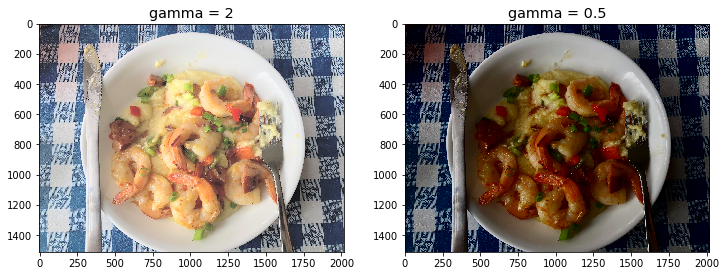

In [6]:
image_hsv = rgb_to_hsv(image_original)

image_hsv_gamma_2_v = gamma_adjust(image_hsv[:, :, 2].astype(np.uint8), 2, which_band=-1)
image_hsv_gamma_2 = np.dstack([image_hsv[:, :, 0], image_hsv[:, :, 1], image_hsv_gamma_2_v])

image_hsv_gamma_0_5_v = gamma_adjust(image_hsv[:, :, 2].astype(np.uint8), 0.5, which_band=-1)
image_hsv_gamma_0_5 = np.dstack([image_hsv[:, :, 0], image_hsv[:, :, 1], image_hsv_gamma_0_5_v])

image_hsv_gamma_2_rgb = hsv_to_rgb(image_hsv_gamma_2)
image_hsv_gamma_0_5_rgb = hsv_to_rgb(image_hsv_gamma_0_5)

fig, axes = plt.subplots(1, 2, figsize=(12, 12))

axes[0].imshow(image_hsv_gamma_2_rgb)
axes[0].set_title('gamma = 2')
axes[1].imshow(image_hsv_gamma_0_5_rgb)
axes[1].set_title('gamma = 0.5')

plt.show()

2.

(b) Linearly increase and linearly decrease the saturation. Reconstruct two new images using the altered S bands via your HSV-to-RGB function. Describe the results. Note that a linear increase may increase the value of the saturation of some pixels to > 1. You will need to clip the results at 1, prior to the conversion back to RGB. Include the results on the same page of your report – either the full images or the same regions from both. Describe the results.

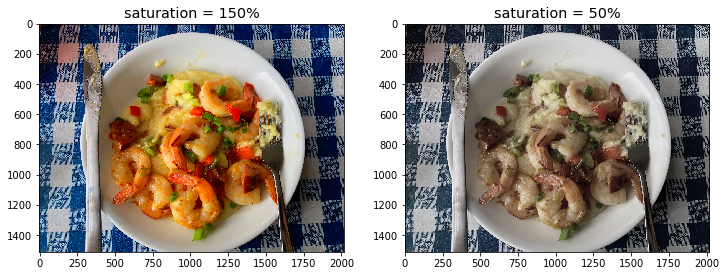

In [7]:
image_hsv_saturation_150_s = np.clip(image_hsv[:, :, 1] * 1.5, 0, 1)
image_hsv_saturation_150 = np.dstack([image_hsv[:, :, 0], image_hsv_saturation_150_s, image_hsv[:, :, 2]])

image_hsv_saturation_150_rgb = hsv_to_rgb(image_hsv_saturation_150)

image_hsv_saturation_50_s = np.clip(image_hsv[:, :, 1] * 0.5, 0, 1)
image_hsv_saturation_50 = np.dstack([image_hsv[:, :, 0], image_hsv_saturation_50_s, image_hsv[:, :, 2]])

image_hsv_saturation_50_rgb = hsv_to_rgb(image_hsv_saturation_50)

fig, axes = plt.subplots(1, 2, figsize=(12, 12))

axes[0].imshow(image_hsv_saturation_150_rgb)
axes[0].set_title('saturation = 150%')
axes[1].imshow(image_hsv_saturation_50_rgb)
axes[1].set_title('saturation = 50%')

plt.show()


2.

(c) Apply a constant circular shift to the H band to shift the colors in the green direction from hue = 0. Note that a circular shift of amount δ away from red toward green could cause the hues of some pixels to exceed 2π. These must be “wrapped around”. That is, if H(r,c) > 2π then replace H(r,c) with H(r,c)−2π. This can be done also with modulo 2π arithmetic.
Repeat the same experiment but shift the colors in the blue direction. Note that you must perform an analogous wrapping to deal with the pixels whose hues are shifted to below zero in value.
Reconstruct 2 new images using the altered H bands via your program HSVtoRGB. Include the results on the the same page of your report – either the full images or the same regions from both. Describe the results. How do these results differ from those of problem 1?

In [8]:
def hue_shift(image_hsv, shift_amount):
    """takes an hsv image and returns it with a shifted hue channel """
    return np.dstack([np.mod(image_hsv[:, :, 0] + shift_amount, 2*np.pi), image_hsv[:, :, 1], image_hsv[:, :, 2]])
    

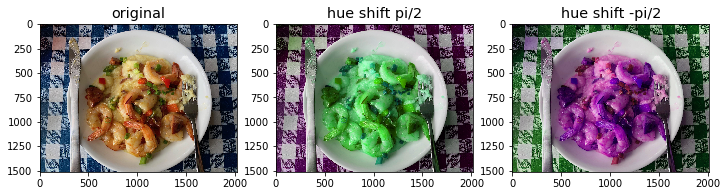

In [9]:
# original_h = image_hsv[:, :, 0]

# shifted_pi_2_h = original_h + np.pi/2
# shifted_pi_2_and_modded_h = np.mod(shifted_pi_2_h, 2*np.pi)
shifted_pi_2 = hue_shift(image_hsv, np.pi/2)
shifted_pi_2_and_modded_rgb = hsv_to_rgb(shifted_pi_2)
# shifted_pi_2_and_modded_rgb = hsv_to_rgb(np.dstack([shifted_pi_2_and_modded_h, image_hsv[:, :, 1], image_hsv[:, :, 2]]))

# shifted_neg_pi_2_h = original_h - np.pi/2
# shifted_neg_pi_2_and_modded_h = np.mod(shifted_neg_pi_2_h, 2*np.pi)
# shifted_neg_pi_2_and_modded_rgb = hsv_to_rgb(np.dstack([shifted_neg_pi_2_and_modded_h, image_hsv[:, :, 1], image_hsv[:, :, 2]]))

shifted_neg_pi_2 = hue_shift(image_hsv, -np.pi/2)
shifted_neg_pi_2_and_modded_rgb = hsv_to_rgb(shifted_neg_pi_2)

fig, axes = plt.subplots(1, 3, figsize=(12, 12))

axes[0].imshow(image_original)
axes[0].set_title('original')

axes[1].imshow(shifted_pi_2_and_modded_rgb)
axes[1].set_title('hue shift pi/2')

axes[2].imshow(shifted_neg_pi_2_and_modded_rgb)
axes[2].set_title('hue shift -pi/2')

plt.show()


3.

Correction of an image with a hue shift. Download the image.

    PhotoDiskTestImageHueShifted.bmp

Download and read,

    PhotoDiskTestImageReadMe.pdf

from the lab assignment 3 folder on Brightspace. The readme file contains information about the image. The image has been hue shifted into an unnatural color spectrum. Convert the image into HSV and try to shift it back into the correct color range. There are reference colors in the matrix of squares in the second row of objects. The row of colors just above the grayscale blocks are blue, green, red, yellow, magenta, and cyan. Include your estimate of the color shift in degrees from the correctly colored image to the discolored one. E.g. d ∈ {−π, π} such that the hues in the discolored image were d+ the hues in the original image. Include the original, discolored image and the color corrected image in your report.

#### Answer: -3/pi, or -60 degrees, seems to be the correct shift back

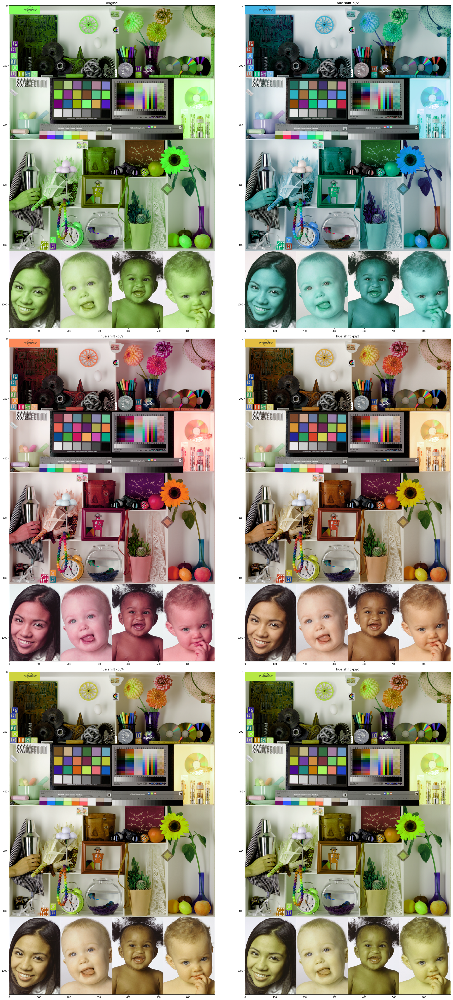

In [10]:
photo_disk = plt.imread('PhotoDiskTestImageHueShifted.bmp')
photo_disk_hsv = rgb_to_hsv(photo_disk)
photo_disk_hsv_pi_2 = hue_shift(photo_disk_hsv, np.pi/2)
photo_disk_hsv_neg_pi_2 = hue_shift(photo_disk_hsv, -np.pi/2)
photo_disk_hsv_neg_pi_3 = hue_shift(photo_disk_hsv, -np.pi/3)
photo_disk_hsv_neg_pi_4 = hue_shift(photo_disk_hsv, -np.pi/4)
photo_disk_hsv_neg_pi_6 = hue_shift(photo_disk_hsv, -np.pi/6)


fig, axes = plt.subplots(3, 2, figsize=(30, 60))

axes[0, 0].imshow(photo_disk)
axes[0, 0].set_title('original')

axes[0, 1].imshow(hsv_to_rgb(photo_disk_hsv_pi_2))
axes[0, 1].set_title('hue shift pi/2')

axes[1, 0].imshow(hsv_to_rgb(photo_disk_hsv_neg_pi_2))
axes[1, 0].set_title('hue shift -pi/2')

axes[1, 1].imshow(hsv_to_rgb(photo_disk_hsv_neg_pi_3))
axes[1, 1].set_title('hue shift -pi/3')

axes[2, 0].imshow(hsv_to_rgb(photo_disk_hsv_neg_pi_4))
axes[2, 0].set_title('hue shift -pi/4')

axes[2, 1].imshow(hsv_to_rgb(photo_disk_hsv_neg_pi_6))
axes[2, 1].set_title('hue shift -pi/6')

plt.tight_layout()
plt.show()


4.

Correction of discolored photos through the linear transformation of color vectors.

&nbsp;

(a) Download the image,

    AHS_Hotel_Comicon_667x1000_discolored.bmp

from the lab assignment 3 folder on Brightspace. This image was derived from the original by multiplying each RGB pixel vector through a randomly generated 3x3 rigid rotation matrix. Select 6 (or more) different colors from the original image. That is, record the rgb values from at least 6 different pixel locations in the image. I suggest that you use the Matlab function, ginput, for that purpose.

&nbsp;

To restore the image you will have to estimate what the original colors were. Here are some hints:

- Ms. Bassett’s blouse is a highly saturated yellow. Her jeans are blue.
- Mr. Peters’ shirt is nearly black with a slight magenta tint.
- Ms. Paulson’s blouse is white with an almost imperceptible magenta cast.
- Ms. Bates’ scarf background is a very slightly desaturated bright red.
- Mr. Bomers’ shirt’s light stripes are nearly middle gray with a slight cyan tint.
- The ”COMICCON” lettering is a slightly desaturated yellow (darker than Ms. Bassett’s blouse.)
- The bacground surrounding the eye in the ComicCon logo is sky blue.

&nbsp;

Make a table that lists the pixel locations and the corresponding rgb triplets from the image and the colors you chose to map to them.

/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:457: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


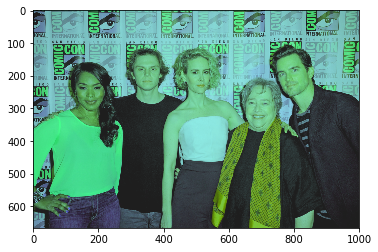

In [11]:
fname = 'AHS_Hotel_Comicon_667x1000_discolored.bmp'
hotel = plt.imread(fname)
plt.imshow(hotel)
plt.ginput()
plt.show()

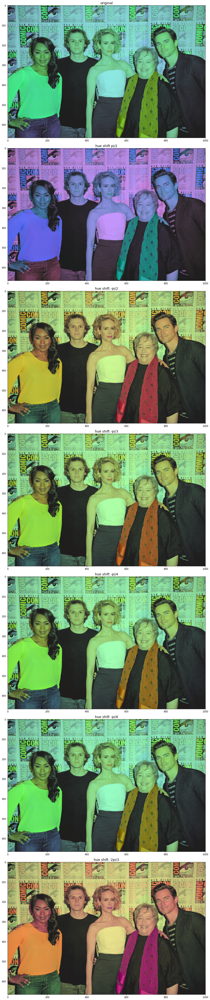

In [15]:
hotel_hsv = rgb_to_hsv(hotel)
hotel_hsv_pi_2 = hue_shift(hotel_hsv, np.pi/2)
hotel_hsv_neg_pi_2 = hue_shift(hotel_hsv, -np.pi/2)
hotel_hsv_neg_pi_3 = hue_shift(hotel_hsv, -np.pi/3)
hotel_hsv_neg_pi_4 = hue_shift(hotel_hsv, -np.pi/4)
hotel_hsv_neg_pi_6 = hue_shift(hotel_hsv, -np.pi/6)
hotel_hsv_neg_2pi_3 = hue_shift(hotel_hsv, -2*np.pi/3)


fig, axes = plt.subplots(7, 1, figsize=(30, 60))

axes[0].imshow(hotel)
axes[0].set_title('original')

axes[1].imshow(hsv_to_rgb(hotel_hsv_pi_2))
axes[1].set_title('hue shift pi/2')

axes[2].imshow(hsv_to_rgb(hotel_hsv_neg_pi_2))
axes[2].set_title('hue shift -pi/2')

axes[3].imshow(hsv_to_rgb(hotel_hsv_neg_pi_3))
axes[3].set_title('hue shift -pi/3')

axes[4].imshow(hsv_to_rgb(hotel_hsv_neg_pi_4))
axes[4].set_title('hue shift -pi/4')

axes[5].imshow(hsv_to_rgb(hotel_hsv_neg_pi_6))
axes[5].set_title('hue shift -pi/6')

axes[6].imshow(hsv_to_rgb(hotel_hsv_neg_2pi_3))
axes[6].set_title('hue shift -2pi/3')

plt.tight_layout()
plt.show()


In [16]:
# Bassett's shirt is yellow: [67, 227, 136] => (255, 255, 102)
# Bassett's jeans are blue: [50, 47, 71] => [0, 0, 255]
# Peters' shirt is black: [34, 38, 38] => [0, 0, 0]
# Paulson's blouse is white: [139, 231, 224] => [255, 255, 255]
# Bates' scarf is red: [101, 157, 7] => [255, 0, 0]
# Bomers' shirt's light stripe is middle grey: [79, 108, 119] => [128, 128, 128]
# COMMICCON letters are darker yellow: [77, 221, 131] => (248, 222, 126)
# COMICCON eye sky is blue: [121, 194, 194] => [135, 206, 250]

In [24]:
import pandas as pd


source_rgb = [
    {
        'x': 33,
        'y': 399,
        'r': 68,
        'g': 228,
        'b': 137,
        'goal_r': 255,
        'goal_g': 255,
        'goal_b': 102,
    },
    {
        'x': 243,
        'y': 550,
        'r': 54,
        'g': 51,
        'b': 79,
        'goal_r': 0,
        'goal_g': 0,
        'goal_b': 255,
    },
    {
        'x': 344,
        'y': 340,
        'r': 36,
        'g': 40,
        'b': 40,
        'goal_r': 0,
        'goal_g': 0,
        'goal_b': 0,
    },
    {
        'x': 531,
        'y': 350,
        'r': 139,
        'g': 232,
        'b': 226,
        'goal_r': 255,
        'goal_g': 255,
        'goal_b': 255,
    },
    {
        'x': 576,
        'y': 572,
        'r': 97,
        'g': 149,
        'b': 6,
        'goal_r': 255,
        'goal_g': 0,
        'goal_b': 0,
    },
    {
        'x': 839,
        'y': 339,
        'r': 91,
        'g': 134,
        'b': 145,
        'goal_r': 128,
        'goal_g': 128,
        'goal_b': 128,
    },
    {
        'x': 99,
        'y': 112,
        'r': 70,
        'g': 213,
        'b': 114,
        'goal_r': 248,
        'goal_g': 222,
        'goal_b': 126,
    },
    {
        'x': 104,
        'y': 148,
        'r': 107,
        'g': 148,
        'b': 184,
        'goal_r': 135,
        'goal_g': 206,
        'goal_b': 250,
    }
]


source_rgb_df = pd.DataFrame(source_rgb)
source_rgb_df

,b,g,goal_b,goal_g,goal_r,r,x,y
0,137,228,102,255,255,68,33,399
1,79,51,255,0,0,54,243,550
2,40,40,0,0,0,36,344,340
3,226,232,255,255,255,139,531,350
4,6,149,0,0,255,97,576,572
5,145,134,128,128,128,91,839,339
6,114,213,126,222,248,70,99,112
7,184,148,250,206,135,107,104,148


4.

(b) Construct a linear transformation matrix from the selected colors. Refer to slides 45-73 of the Color Correction lecture. List the transform matrix.

In [53]:
X = source_rgb_df[['r', 'g', 'b']]
Y = source_rgb_df[['goal_r', 'goal_g', 'goal_b']]
X = np.array(X).T/255
Y = np.array(Y).T/255
print('rank =', numpy.linalg.matrix_rank(X @ X.T))

rank = 3


In [54]:
B = Y @ X.T @ np.linalg.inv(X @ X.T)
print(B)

[[ 0.33772963  1.475725   -0.69852105]
 [-1.69142849  1.0155971   1.09432886]
 [ 0.77600793 -0.55863237  1.32206865]]


4.

(c) Transform the altered image using the transformation matrix. Display the original and the result, plot their pdfs, and comment on the differences between the two images.

uint8
(667, 1000, 3)


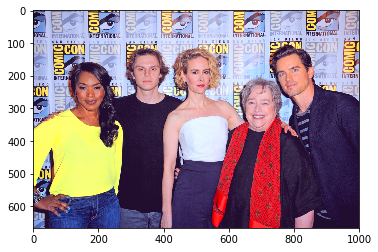

In [61]:
print(hotel.dtype)
hotel_restored = np.clip(np.rint(np.tensordot(hotel.astype(float)/255, B.T, axes=1) * 255), 0, 255).astype(np.uint8)
print(hotel_restored.shape)
plt.imshow(hotel_restored)
plt.show()

5.

In Homework 3 you wrote a program that accepts an arbitrary RGB image I, converts the image into X, Y , and Z bands and outputs them. E.g.

    >> [X,Y,Z] = RGBtoXYZ( I, M );
    
M, X, Y , and Z are of type double. I is of type uint8. And you wrote a program that computes the inverse,

    >> J = XYZtoRGB( X, Y, Z, M );
    
where J is uint8.

In [97]:
def rgb_to_xyz(image, M):
    image = image.astype(float) / 255.
    
    mask = image > 0.04045
    image[mask] = np.power((image[mask] + 0.055) / 1.055, 2.4)
    image[~mask] /= 12.92
    
    return np.tensordot(image, M, axes=1)


def xyz_to_rgb(image, M):
    image = np.tensordot(image, np.linalg.inv(M), axes=1)
    mask = image > 0.0031308
    image[mask] =  np.power(image[mask], 1. / 2.4) * 1.055 - 0.055
    image[~mask] *= 12.92
    return np.rint(image * 255.).clip(0, 255).astype(np.uint8)

5.

Write a program that converts X, Y, and Z bands with one illuminant, vs, to X, Y , and Z bands with another illuminant, vd. You will need to construct a Bradford Matrix as shown on p. 16.


    >> [X,Y,Z] = XYZtoXYZ( Xsrc, Ysrc, Zsrc, vsrc, vdst );

In [88]:
# p16
cone_response_matrix = np.array([[0.8951, 0.2664, -0.1614],
                                 [-0.7502, 1.7135, 0.0367],
                                 [0.0389, -0.0685, 1.0296]])
# print(np.linalg.inv(cone_response_matrix))

div_diag = np.array([[0.9781312127, 0, 0],
                     [0, 0.989010989, 0],
                     [0, 0, 0.630752374],
])

correct_bfd = np.array([[1.0478, 0.0229, -0.0501],
                        [0.0295, 0.9905, -0.0171],
                        [-0.0092, 0.0150, 0.7521]])

print('page 16\'s bfd should have been', np.linalg.inv(cone_response_matrix) @ div_diag @ cone_response_matrix)
destination_white = np.array([24.60, 23.40, 34.54])
source_white = np.array([25.15, 23.66, 45.76])

# print(correct_bfd @ np.array(source_white).T)
# print(np.linalg.inv(cone_response_matrix) @ div_diag @ cone_response_matrix)

# np.diag(div).shape
def get_bradford_matrix(source_white, destination_white):
    div = np.divide(destination_white, source_white)
    return np.linalg.inv(cone_response_matrix) @ np.diag(div) @ cone_response_matrix

# print(np.array(source_white) @ get_bradford_matrix(source_white, destination_white))


def xyz_to_xyz(xyz, source_white, destination_white):
    bfd = get_bradford_matrix(source_white, destination_white)
    return np.tensordot(xyz, bfd, axes=1)

# print(xyz_to_xyz(source_white[None, None, :], source_white, destination_white))

page 16's bfd should have been [[ 0.97716989  0.00106492 -0.05727116]
 [-0.00489693  0.98896765 -0.01742259]
 [-0.01341403  0.02379208  0.63175704]]


5.

Write two programs, one that converts X, Y , Z, and v into L∗, a∗, and b∗ bands, the
other that computes the inverse.

```
>> [L,a,b] = XYZtoLab( X, Y, Z, v );
>> [X,Y,Z] = LabtoXYZ( L, a, b, v );
```

In [ ]:
# pg. 14
def xyz_to_lab(xyz, illuminant):
    xyz = xyz / np.array(illuminant)[None, None, :] # divide by illuminant
    
    y = xyz[:, :, 1]
    l = np.zeros_like(y)
    
    mask = y > 0.008856
    l[mask] = 116. * np.power(y[mask], 1./3.) - 16.
    l[~mask] = 903.3 * y[~mask]
    a = 500. * (np.power(x, 1./3.) - np.power(y, 1./3.))
    b = 200. * (np.power(y, 1./3.) - np.power(z, 1./3.))
    return np.dstack([l, a, b])


# pg. 27
# "Note: When transforming XYZ data back to L*a*b*, using Equation (3), 
# make sure that the Xn, Yn, and Zn coordinates are the ones of the 
# illuminant used to measure XYZ. If you want L*a*b* coordinates for 
# a different illuminant, you first have to convert the XYZ data to 
# the new illuminant using a Bradford matrix."
def lab_to_xyz(lab, v):
    L = lab[:, :, 0]
    a = lab[:, :, 1]
    b = lab[:, :, 2]
    
    v_x, v_y, v_z = v
    
    x = np.zeros_like(a)
    y = np.zeros_like(b)
    z = np.zeros_like()
    
    mask = L > 8000.
    
    
    L_rescaled_positive = (L[mask] + 16.)/116.
    x[mask] = v_x * np.power(L_rescaled_positive + a[mask] / 500., 3)
    y[mask] = v_y * np.power(L_rescaled_positive, 3)
    z[mask] = v_z * np.power(L_rescaled_positive - b[mask] / 200., 3)
    
    
    
    L_rescaled_negative = L[~mask] / 903.3
    L_rescaled_negative_powered = np.power(L_rescaled_negative, 1./3.)
    
    x[~mask] = v_x * np.power(L_rescaled_negative_powered + a[~mask]/500., 3)
    y[~mask] = v_y * L_rescaled_negative
    z[~mask] = v_z * np.power(L_rescaled_negative_powered - b[~mask]/200., 3)
    
    return np.dstack([x, y, z])

5.

Verify that these two programs are inverses by using the same 9 × 9 × 3 block from the X, Y , and Z bands that you generated from your RGB image.

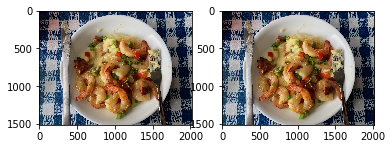

In [98]:
# # p21
M = np.array([[0.4125, 0.3576, 0.1804],
              [0.2127, 0.7152, 0.0722],
              [0.0193, 0.1192, 0.9503]])
image_xyz = rgb_to_xyz(image_original, M)
image_back = xyz_to_rgb(image_xyz, M)
# plt.imshow(cutout)
# rgb_to_xyz()

# xyz_to_lab
fig, axes = plt.subplots(1, 2)
axes[0].imshow(image_original)
axes[1].imshow(image_back)

plt.show()

&nbsp;

Determine the natures of the L∗, a∗, and b∗ bands by performing some experiments as follows:

&nbsp;

Find a richly colored RGB image and convert it into L∗, a∗, and b∗ bands using your programs, RGBtoXYZ and XYZtoLab. Indicate which M and v you used, and why you selected them. Then perform some point operations on the L band. Reconvert the resultant L∗s, and the original a∗, and b∗ bands into RGB images using LabtoXYZ and XYZtoRGB. Do other (or the same) point operations on the a∗ band alone, and an others on the b∗ band alone and reconstruct the results. The goal is to determine the information carried in each of these bands. Use the original image and a subset (at least one for each band) of your modified RGB images to support your explanations.